<a href="https://colab.research.google.com/github/ohashi-gnct/exp4e/blob/master/multimedia.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

まず、データを読み込むため自分のGoogleドライブをマウント

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


ドライブ直下にpngファイルを置くと、

`/content/drive/MyDrive/hoge.png`と指定すればファイルが使える

In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib import animation, rc
from IPython.display import HTML, Image # For GIF
import librosa
import librosa.display
import soundfile as sf
from IPython.display import display, Audio


rc('animation', html='html5')

## 0. 基礎知識



### 基本的な波形と周波数スペクトル

正弦波、方形波、三角波を例に、スペクトルを表示する

#### 正弦波

当たり前だが、正弦波は1つの周波数の正弦波に分解できる

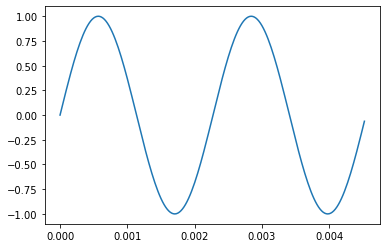

In [ ]:
sr1 = 44000
freq = 440
 
x = np.linspace(0, 1, sr1)
y_sine = np.sin(freq*2*np.pi*x)
 
plt.plot(x[0:200], y_sine[0:200])
display(Audio(y_sine, rate=sr1))

In [ ]:
def show_spectrum(y, sr, max_freq=5000):
  F = np.abs(np.fft.fft(y))
  plt.title('amplitude spectrum')
  plt.plot(range(sr)[:max_freq], F[:max_freq])

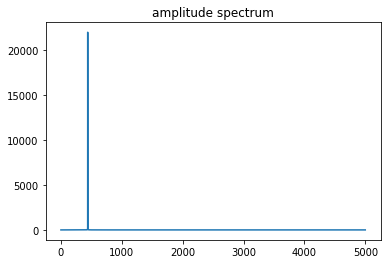

In [ ]:
show_spectrum(y_sine, sr1)

#### 方形波

方形波は、基本となる周波数と、その3倍、5倍、7倍…の正弦波に分解できる。

倍数が大きくなるほど、そのエネルギー（振幅）は小さくなる


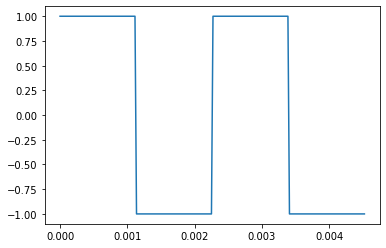

In [ ]:
y_square = np.sin(freq*2*np.pi*x)
for i in range(len(y_square)):
  if y_square[i] >= 0:
    y_square[i] = 1
  else:
    y_square[i] = -1

plt.plot(x[0:200], y_square[0:200])
display(Audio(y_square, rate=sr1))

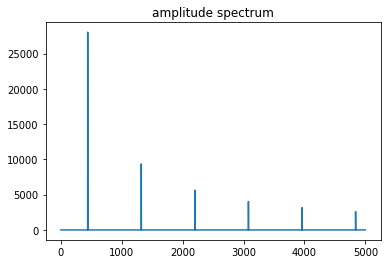

In [ ]:
show_spectrum(y_square, sr1)

#### 三角波

三角波も同様に、基本となる周波数と、その3倍、5倍、7倍…の正弦波に分解できる。

方形波と比べると、高調波の減衰が早いことがわかる

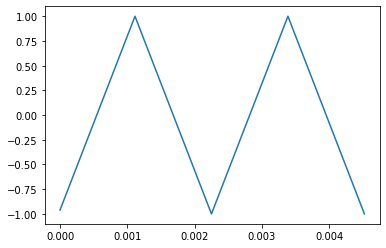

In [ ]:
y_triangle = np.sin(freq*2*np.pi*x)
for i in range(len(y_triangle)):
  if y_triangle[i] >= 0:
    y_triangle[i] = 1
  else:
    y_triangle[i] = -1
temp = 0
for i in range(len(y_triangle)):
  temp += y_triangle[i]
  y_triangle[i] = temp
y_triangle = y_triangle / np.max(y_triangle) * 2 - 1

plt.plot(x[0:200], y_triangle[0:200])
display(Audio(y_triangle, rate=sr1))

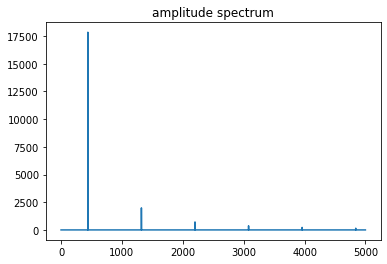

In [ ]:
show_spectrum(y_triangle, sr1)



### 画像データのフーリエ解析



まずは中身を見てみる

`print()`すると、中身は`int`の配列になっていることがわかる

matplotplibで画像として`show`してみる

[[162 162 162 ... 169 154 128]
 [162 162 162 ... 169 154 128]
 [162 162 162 ... 169 154 128]
 ...
 [ 42  42  49 ... 104 100  98]
 [ 43  43  54 ... 103 105 107]
 [ 43  43  54 ... 103 105 107]]


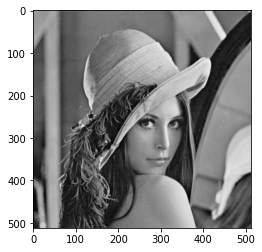

In [ ]:
# グレースケールで画像を読み込み
img = cv2.imread('/content/drive/MyDrive/lena_std.png',0)
print(img)
plt.gray()
plt.imshow(img)           
plt.show()

numpyの`numpy.fft.fft2()`でFFT（高速フーリエ変換）すると、

画像の周波数スペクトルが表示される

まんなかを中心として、離れるほど高周波

[[138.47257256 152.46568605 110.48751393 ... 121.48359688 110.48751393
  152.46568605]
 [141.27560245 133.8048226  108.67016019 ... 130.62120544 142.54288095
  144.52451112]
 [131.15325822 125.60426465 134.37545433 ... 142.55102609 133.89738587
  109.71611577]
 ...
 [129.59443041 144.45351966 141.16024443 ... 135.87820873 131.51403438
  130.65358253]
 [131.15325822 109.71611577 133.89738587 ... 115.19878932 134.37545433
  125.60426465]
 [141.27560245 144.52451112 142.54288095 ... 151.68548781 108.67016019
  133.8048226 ]]


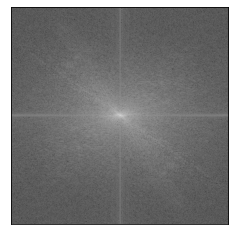

In [ ]:
img_fft = np.fft.fft2(img)
fshift = np.fft.fftshift(img_fft)
magnitude_spectrum = 20*np.log(np.abs(fshift))

print(magnitude_spectrum)
plt.gray()
plt.imshow(magnitude_spectrum) 
plt.xticks([])
plt.yticks([])          
plt.show()

FFTしたスペクトル`img_fft`をもとに、

画像を再構成してみる

もとの画像に戻った


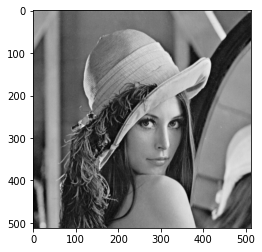

In [ ]:
ifimage = np.fft.ifft2(img_fft) 
ifimage = ifimage.real

plt.gray()
plt.imshow(ifimage)           
plt.show()


### 音声データのフーリエ解析

LibROSAにあるサンプル曲を読み込み、

波形とスペクトログラム（周波数スペクトルの時間変化）を出す

人間は高周波ほど小さな周波数の変化を認識できなくなるため、

高周波ほど荒いメル尺度でスペクトログラムを表示する

In [ ]:
def show_spectrogram(y, sr):
  S = librosa.feature.melspectrogram(y, sr=sr, n_mels=128)
  log_S = librosa.power_to_db(S, ref=np.max)
  plt.figure(figsize=(10, 4))
  librosa.display.specshow(log_S, sr=sr, x_axis='time', y_axis='mel')
  plt.title('mel power spectrogram')
  plt.colorbar(format='%+02.0f dB')
  plt.show()

def show_wave_spectrogram_audio(y, sr):
  fig, [ax_wave, ax_spectrogram] = plt.subplots(2, 1, figsize=(12, 10))
  S = librosa.feature.melspectrogram(y, sr=sr, n_mels=128)
  log_S = librosa.power_to_db(S, ref=np.max)
  librosa.display.waveplot(y, sr=sr, x_axis='time', ax=ax_wave)
  spectrogram = librosa.display.specshow(log_S, sr=sr, x_axis='time', y_axis='mel', ax=ax_spectrogram)
  plt.show()
  display(Audio(y, rate=sr))

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


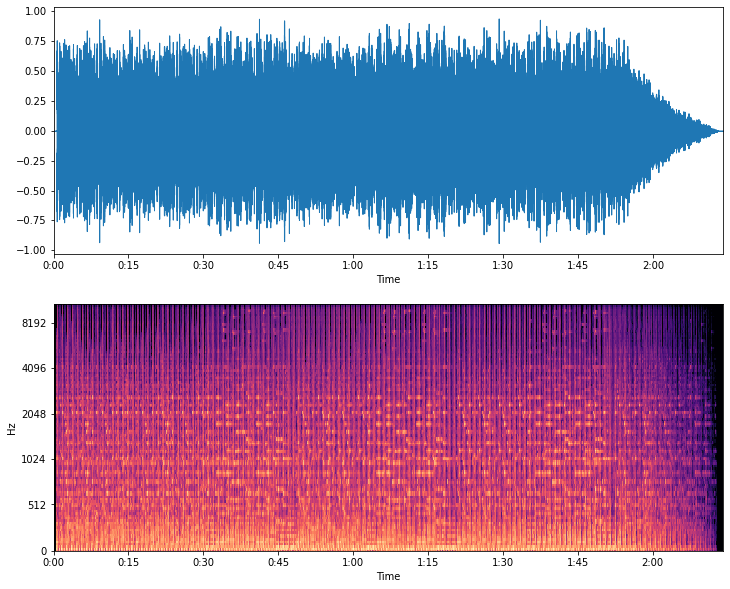

In [ ]:
y, sr = librosa.load('/content/drive/MyDrive/famipop3.mp3', mono=True)

show_wave_spectrogram_audio(y, sr)

## 1. 画像の周波数領域フィルタ（必須課題）

先ほどのlenaのスペクトルを見てみる



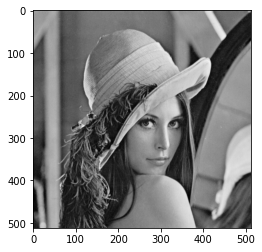

これをフーリエ変換すると、以下のようなスペクトルが表示された

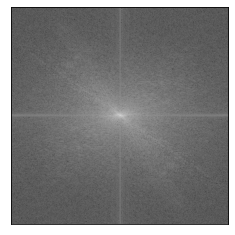


周波数と聞くと1次元のイメージだが、

なぜ2次元で表示されているのだろう？

さまざまな画像を入力し、スペクトルの出かたを比べてほしい

http://www.ess.ic.kanagawa-it.ac.jp/app_images_j.html より画像引用


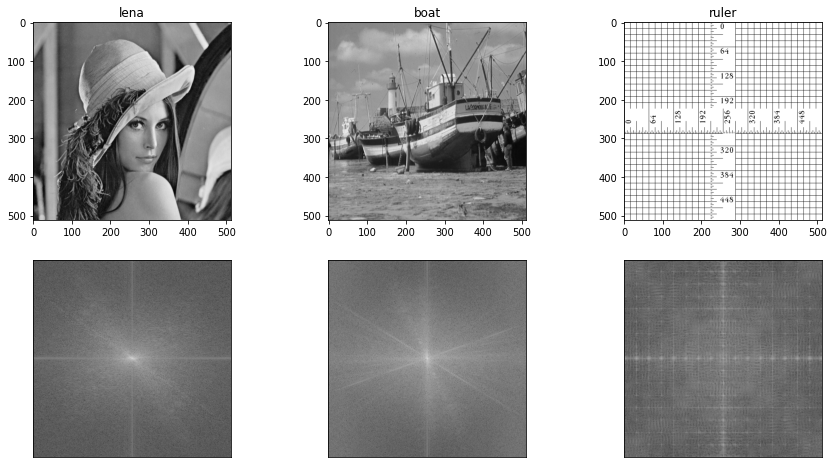

In [ ]:
def calc_spectrum(img):
  img_fft = np.fft.fft2(img)
  fshift = np.fft.fftshift(img_fft)
  return 20*np.log(np.abs(fshift))

# ここのファイル名を変える
img1 = cv2.imread('/content/drive/MyDrive/lena_std.png',0)
img2 = cv2.imread('/content/drive/MyDrive/Fishing-Boat.png',0)
img3 = cv2.imread('/content/drive/MyDrive/Pixel-ruler.png',0)


fig, [[ax1, ax2, ax3], [ax1_fft, ax2_fft, ax3_fft]] = plt.subplots(2, 3, figsize=(15, 8))

ax1.imshow(img1)
# ここのタイトルを変えると、図のタイトルに反映される
ax1.set_title("lena")
ax1_fft.imshow(calc_spectrum(img1))
ax1_fft.set_xticks([])
ax1_fft.set_yticks([])

ax2.imshow(img2)
# ここもタイトルを変えてもよい
ax2.set_title("boat")
ax2_fft.imshow(calc_spectrum(img2))
ax2_fft.set_xticks([])
ax2_fft.set_yticks([])

ax3.imshow(img3)
# ここもタイトルを変えてもよい
ax3.set_title("ruler")
ax3_fft.imshow(calc_spectrum(img3))
ax3_fft.set_xticks([])
ax3_fft.set_yticks([])

plt.show()

**↑の図を3.1の結果として授業中に提出**

スペクトルに対して操作を行うことで、周波数領域から画像を処理できる。

ローパスフィルターをかけてみる。

スペクトルの中心部だけ残すようにスペクトルをマスクすると、

ローパスフィルターとして機能する

再構成した画像は、帽子などの輪郭のまわりに波のような模様が出てしまった

この波は何だろうか？

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:21: RuntimeWarning: divide by zero encountered in log


<Figure size 432x288 with 0 Axes>

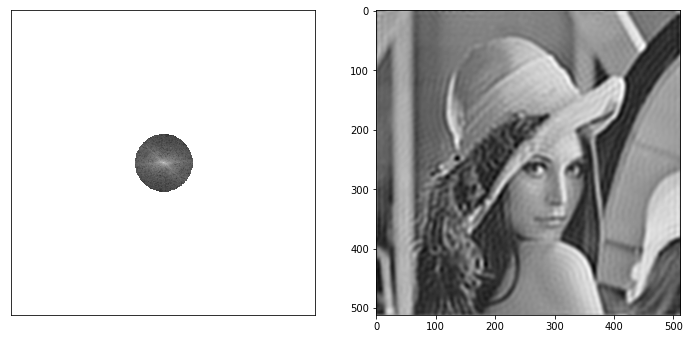

In [ ]:
img = cv2.imread('/content/drive/MyDrive/lena_std.png',0)

size = img.shape
mask = np.zeros(size)
length = size[0]
centery = size[0]/2


# ここのRを大きくすればするほど、高周波まで通す
R = 50
for x in range(0,length):
    for y in range(0,length):
        if (x- centery)**2 +(y- centery)**2 <R**2:
            mask[x,y]=1

plt.gray()
fig, [ax_fft, ax_image] = plt.subplots(1, 2, figsize=(12, 8))
img_fft = np.fft.fft2(img)
fshift = np.fft.fftshift(img_fft)
fshift_mask = fshift*mask
magnitude_spectrum = 20*np.log(np.abs(fshift_mask))
ax_fft.imshow(magnitude_spectrum)           
ax_fft.set_xticks([])
ax_fft.set_yticks([])

fshift_mask= np.fft.fftshift(fshift_mask) 
ifimage = np.fft.ifft2(fshift_mask) 
ifimage = ifimage.real
ax_image.imshow(ifimage)           
plt.show()


周波数（半径）を変えて、アニメーションを作ってみる

低周波の領域だけで再構成しても、

画像の（見た目の）特徴をある程度残しているように見える

→高周波の情報を減らすことで、見た目をそのままに

画像のデータ量を減らすことができる？

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in log


<Figure size 432x288 with 0 Axes>

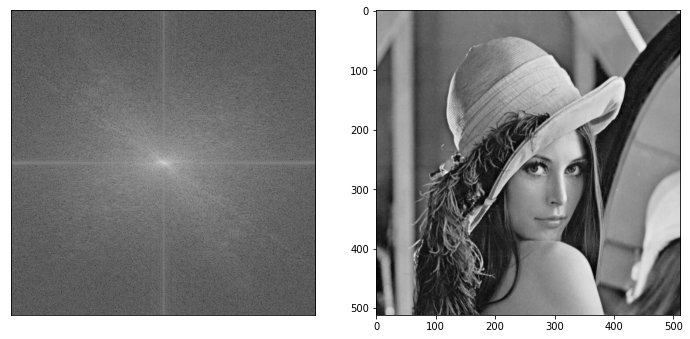

In [ ]:
def mask_to_fshift(fshift, R):
  size = fshift.shape
  mask = np.zeros(size)
  length = size[0]
  centery = size[0]/2
  for x in range(0,length):
    for y in range(0,length):
      if (x- centery)**2 +(y- centery)**2 <R**2:
        mask[x,y]=1
  return fshift*mask


plt.gray()
ims = []
fig, [ax_fft, ax_image] = plt.subplots(1, 2, figsize=(12, 8))
for i in range(50):
  fshift_mask = mask_to_fshift(fshift.copy(), 1.15**i)
  magnitude_spectrum = 20*np.log(np.abs(fshift_mask))
  im_fft = ax_fft.imshow(magnitude_spectrum)
  ax_fft.set_xticks([])
  ax_fft.set_yticks([])

  fshift_mask= np.fft.fftshift(fshift_mask) 
  ifimage = np.fft.ifft2(fshift_mask) 
  ifimage = ifimage.real
  im_image = ax_image.imshow(ifimage)    
  

  ims.append([im_fft, im_image])  

ani = animation.ArtistAnimation(fig, ims, interval=100, blit=True,
                                repeat_delay=1000)
ani.save('anim.gif', writer = "pillow", fps=20)
HTML(ani.to_html5_video())


## 2. 画像の空間領域フィルタと周波数（必須課題）

2年生の実験で画像のフィルタリングを学習した。

画像に対して、例えば5x5のフィルタを畳み込む

画像の平滑化フィルタとして、

移動平均フィルタ`kernel_movingaverage`と、

ガウシアンフィルタ`kernel_gaussian`を用意した。

フィルタの重みは違うようだが、見た目ではどのように異なっているか？

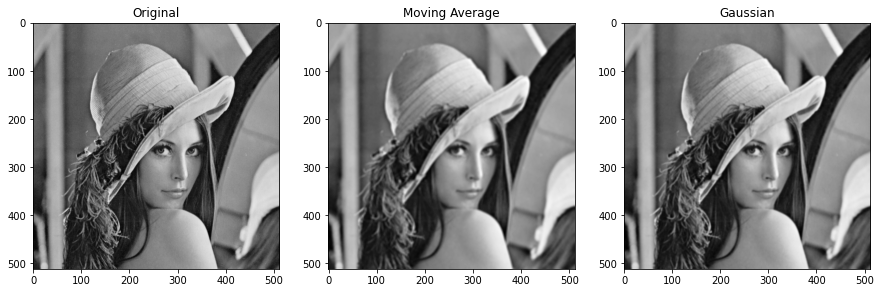

In [ ]:
# 5x5 のフィルタを使っている。好きなフィルタに変えてみてもよい
kernel_original = np.array([[0, 0, 0, 0, 0],
                            [0, 0, 0, 0, 0],
                            [0, 0, 1, 0, 0],
                            [0, 0, 0, 0, 0],
                            [0, 0, 0, 0, 0]])

kernel_movingaverage = np.array([[1, 1, 1, 1, 1],
                                 [1, 1, 1, 1, 1],
                                 [1, 1, 1, 1, 1],
                                 [1, 1, 1, 1, 1],
                                 [1, 1, 1, 1, 1]]) / 25

kernel_gaussian = np.array([[1,  4,  6,  4, 1],
                            [4, 16, 24, 16, 4],
                            [6, 24, 36, 24, 6],
                            [4, 16, 24, 16, 4],
                            [1,  4,  6,  4, 1]]) / 256

fig, [ax_img_original, ax_img_movingaverage, ax_img_gaussian] = plt.subplots(1, 3, figsize=(15, 8))

img = cv2.imread('/content/drive/MyDrive/lena_std.png',0)

img_original = cv2.filter2D(img, -1, kernel_original)
ax_img_original.imshow(img_original)
ax_img_original.set_title("Original")

img_movingaverage = cv2.filter2D(img, -1, kernel_movingaverage)
ax_img_movingaverage.imshow(img_movingaverage)
ax_img_movingaverage.set_title("Moving Average")

img_gaussian = cv2.filter2D(img, -1, kernel_gaussian)
ax_img_gaussian.imshow(img_gaussian)
ax_img_gaussian.set_title("Gaussian")

plt.show()

#### 移動平均フィルタ

フィルタを3x3, 5x5, 7x7…と大きくしてアニメーションを作成する

フィルタが大きいほど平滑化の効果は強くなる

周波数領域で見ると、どんな役割をしているか？

網目のような模様が見える。これは何？



In [ ]:
def calc_spectrum(img):
  img_fft = np.fft.fft2(img)
  fshift = np.fft.fftshift(img_fft)
  return 20*np.log(np.abs(fshift))

<Figure size 432x288 with 0 Axes>

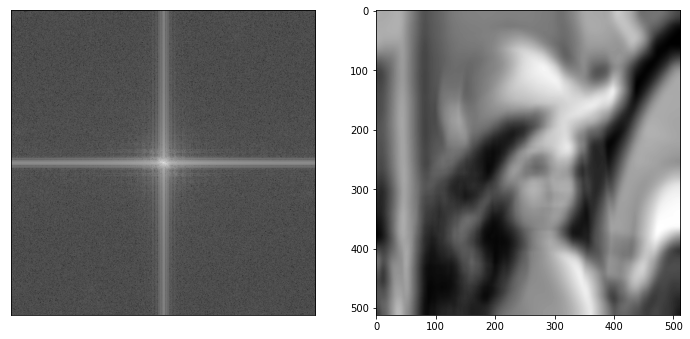

In [ ]:
plt.gray()
ims = []
fig, [ax_fft, ax_image] = plt.subplots(1, 2, figsize=(12, 8))
for i in range(1, 40, 2):
  img_movingaverage = cv2.blur(img, (i, i))
  im_image = ax_image.imshow(img_movingaverage)   
  
  im_fft = ax_fft.imshow(calc_spectrum(img_movingaverage))
  ax_fft.set_xticks([])
  ax_fft.set_yticks([])
  
  ims.append([im_image, im_fft])  

ani = animation.ArtistAnimation(fig, ims, interval=100, blit=True,
                                repeat_delay=1000)
ani.save('anim.gif', writer = "pillow", fps=20)
HTML(ani.to_html5_video())

#### ガウシアンフィルタ

ガウシアンフィルタでは、周りの画素を一律に平均するのではなく、

注目している画素の近くに重み付けしてある

$$ f(x, y)=\frac{1}{2\pi\sigma^2} \exp({-\frac{x^2+y^2}{2\sigma^2}})$$

フィルタを3x3, 5x5, 7x7…と大きくし、それに合わせて標準偏差 $ \sigma $ を大きくする

標準偏差が大きいほど平滑化の効果は強くなる

周波数領域で見ると、どんな役割をしているか？

移動平均との違いは何か？

この画像だとわかりにくいので、いろいろな画像を入れて実験してほしい

細かいノイズの多い画像だとわかりやすいかも

<Figure size 432x288 with 0 Axes>

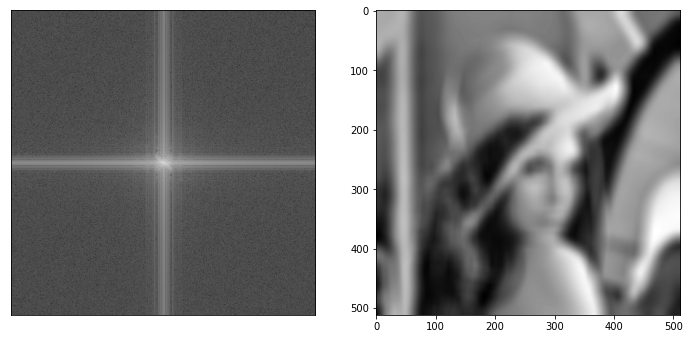

In [ ]:


plt.gray()
ims = []
fig, [ax_fft, ax_image] = plt.subplots(1, 2, figsize=(12, 8))
for i in range(1, 30, 2):
  img_gaussian = cv2.GaussianBlur(img, (i, i), i/2)
  im_image = ax_image.imshow(img_gaussian)   

  im_fft = ax_fft.imshow(calc_spectrum(img_gaussian))
  ax_fft.set_xticks([])
  ax_fft.set_yticks([])

  ims.append([im_image, im_fft])  

ani = animation.ArtistAnimation(fig, ims, interval=100, blit=True,
                                repeat_delay=1000)
ani.save('anim.gif', writer = "pillow", fps=20)
HTML(ani.to_html5_video())

**↑の図を3.2の結果として授業中に提出**

ぼかしのかけ方は適当に調節したほうがよい（上のは

#### 先鋭化

次に、先鋭化フィルタをかけてみる



<Figure size 432x288 with 0 Axes>

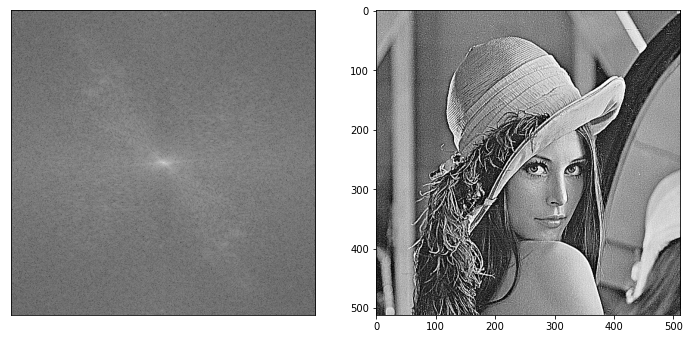

In [ ]:
kernel_sharpen = np.array([[-1, -1, -1],
                           [-1,  9, -1],
                           [-1, -1, -1]])

plt.gray()
fig, [ax_fft, ax_image] = plt.subplots(1, 2, figsize=(12, 8))

img_sharpen = cv2.filter2D(img, -1, kernel_sharpen)

ax_fft.imshow(calc_spectrum(img_sharpen))
ax_fft.set_xticks([])
ax_fft.set_yticks([])
ax_image.imshow(img_sharpen)           
plt.show()

もとの画像↓と比較すると、

画像の細かい部分（エッジ）が際立って表現されている

スペクトルは高周波までまんべんなく出るようになった

画像の高周波とエッジには関係性がある？

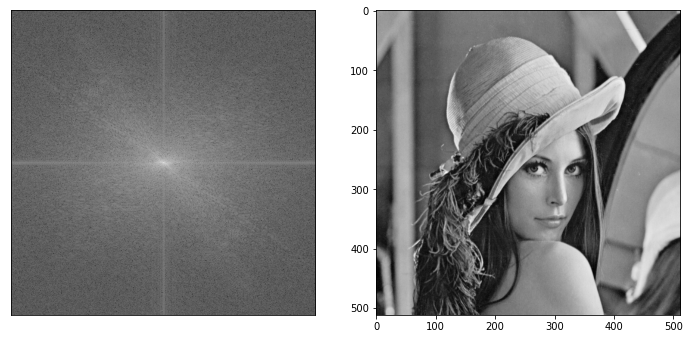

## 3. 音声の周波数領域フィルタ（必須課題）

高周波ノイズが加えられた音声を用意する

ノイズの入った音声のスペクトログラムを見ると、

高周波に強いエネルギーがある

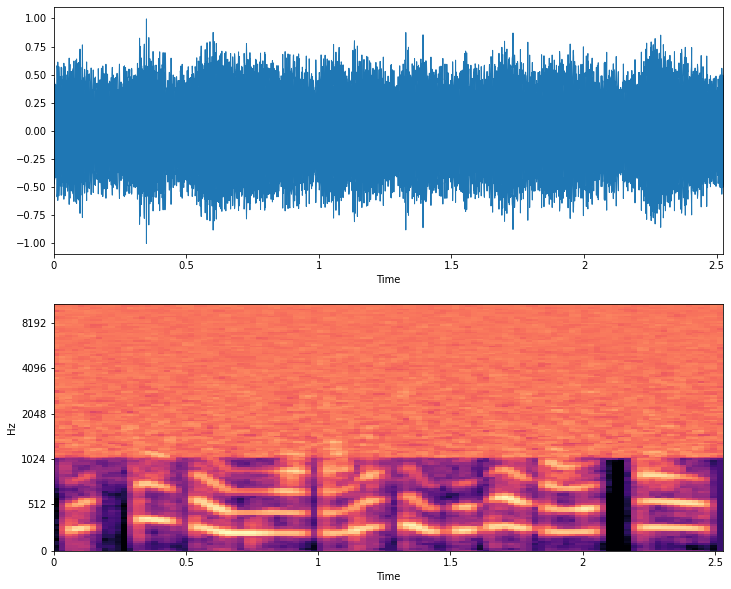

In [ ]:
# ここのファイル名を変える。自分で高周波ノイズ入りの音声を作っても良い
y_voice, sr_voice = librosa.load('/content/drive/MyDrive/voice_with_noise_100.wav')
show_wave_spectrogram_audio(y_voice, sr_voice)

FFTを行い、ある周波数以上をカットすると、ノイズがなくなった

(1025, 109)


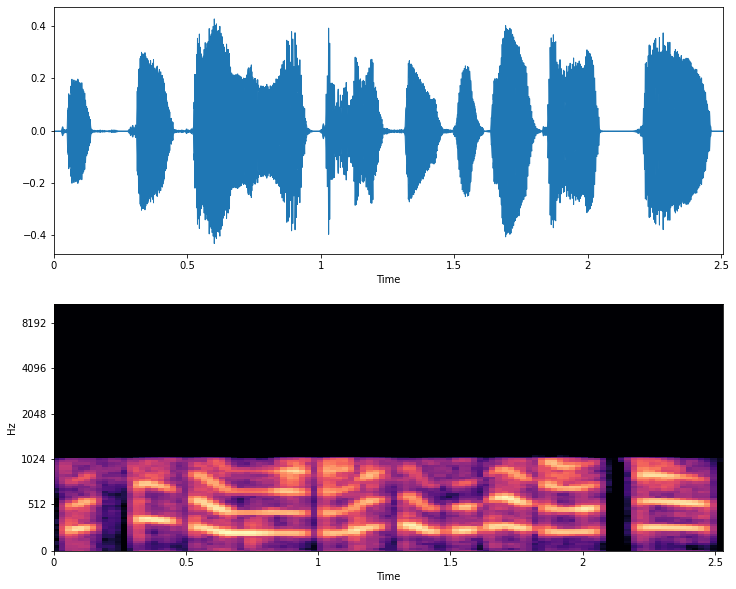

In [ ]:
n_fft = 2048
D = librosa.stft(y_voice, n_fft=n_fft)
print(D.shape)
# ここの96を変えると、どの周波数まで通すかが変わる
# この数値はFFTした配列の話であって、Hzではない。
D[96:] = 0
y_voice_lowpass = librosa.istft(D)
show_wave_spectrogram_audio(y_voice_lowpass, sr_voice)

次は音楽を使ってみる

まずは読み込み

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


(2956608,)
22050


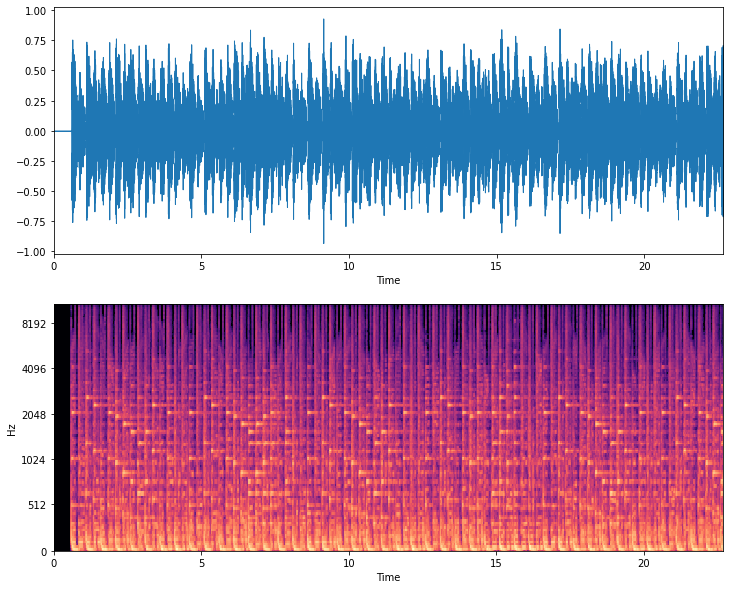

In [ ]:
# ここのファイル名を好きな音楽に変える。mono=Trueでモノラルになる
y_tropical, sr_tropical = librosa.load('/content/drive/MyDrive/famipop3.mp3', mono=True)
print(y_tropical.shape)
print(sr_tropical)
# 曲が長すぎるので適当に切り出す
# サンプリングレートが44100Hzであれば、1秒間に44100サンプルあるということになる
y_tropical = y_tropical[:500000]
show_wave_spectrogram_audio(y_tropical, sr_tropical)

ローパスフィルターやハイパスフィルターを試す

聴覚上の変化はどうなる？スペクトログラム上では？

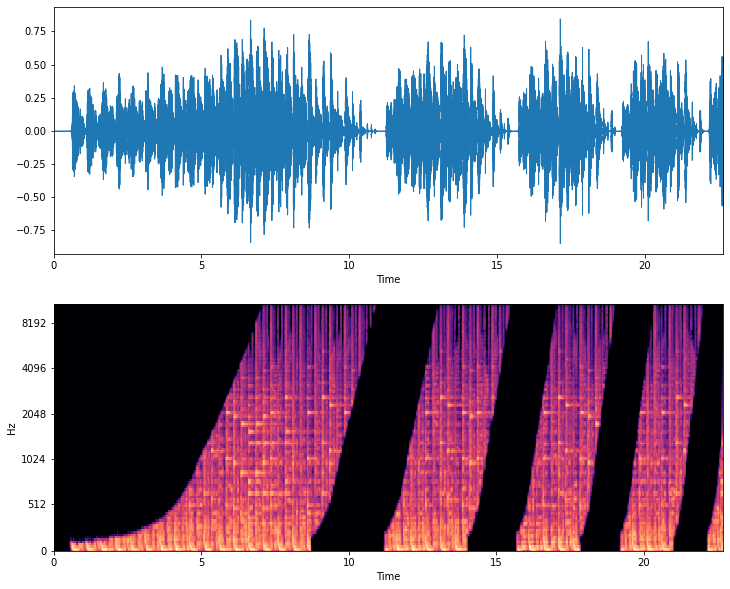

In [ ]:
n_fft = 2048
D = librosa.stft(y_tropical, n_fft=n_fft)
flag = 0
freq_pass = 10
# このフィルタは自由に変えて良い
# ハイパスとローパスを交互にかけると面白いかなと思ってこうしてあるだけ
for i in range(len(D[0])):
  if flag == 0:
    D[int(freq_pass):, i] = 0
    freq_pass *= 1.00 + (i * 0.0001)
    if freq_pass > 10000:
      flag = 1
      freq_pass = 20
  elif flag == 1:
    D[:int(freq_pass), i] = 0
    freq_pass *= 1.00 + (i * 0.0001)
    if freq_pass > 2000:
      flag = 0
      freq_pass = 20

y_tropical_lowpass = librosa.istft(D)
show_wave_spectrogram_audio(y_tropical_lowpass, sr_tropical)

**↑の波形を3.3の結果として授業中に提出**

フィルタは適当に用意したものなので、

自分の気に入る形のフィルタを作って提出すること

もちろん、ただのローパスフィルタでもよい

↓気に入る形のフィルタの例

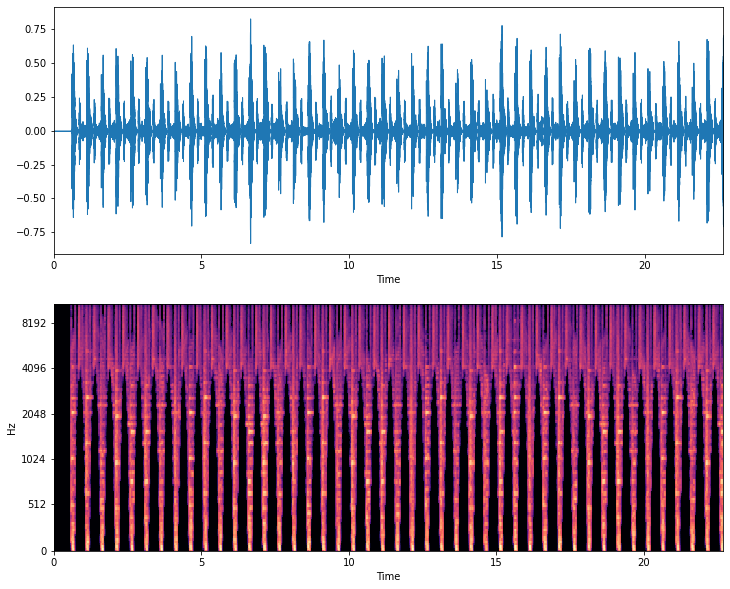

In [ ]:
n_fft = 2048
D = librosa.stft(y_tropical, n_fft=n_fft)
bpm = 120
period = sr_tropical * 60 / bpm
for i in range(len(D[0])):
  D[:int(200 * (1+np.cos(np.pi*(i+4)*n_fft/period/2))), i] = 0

y_tropical_lowpass = librosa.istft(D)
show_wave_spectrogram_audio(y_tropical_lowpass, sr_tropical)

## 4. 音声の時間領域フィルタと周波数（発展課題）

$ n $ 点の平均をとるような移動平均フィルタを設計し、

音楽に畳み込む

聞こえ方はどう変化するか？周波数上ではどうか？

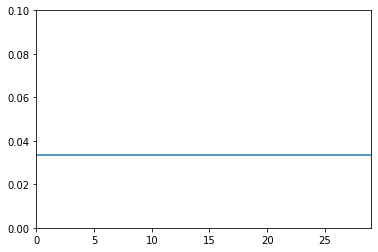

In [ ]:
# nを変えるとフィルタの長さが変わる
# とうぜん長いほど平滑化の効果は大きい
n = 30
filter_movingaverage = np.ones(n)/n
plt.plot(filter_movingaverage)
plt.xlim(0, n-1) 
plt.ylim(0, 0.1)
plt.show()

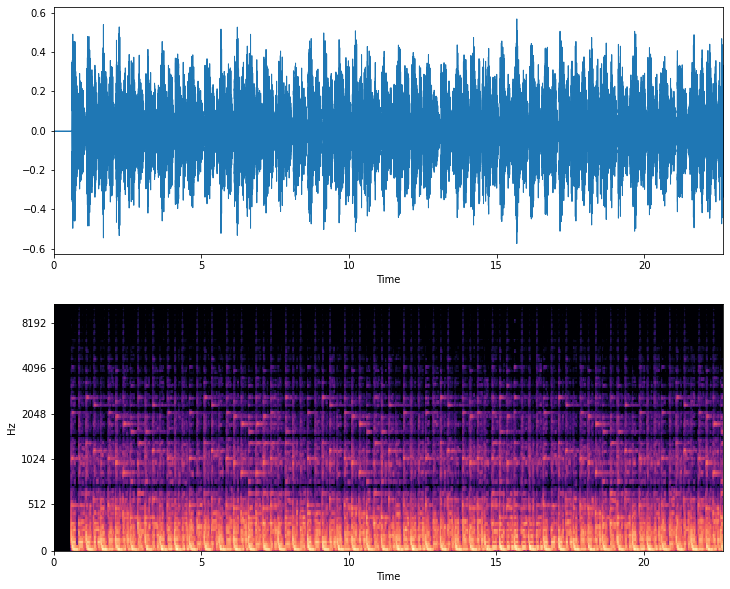

In [ ]:
y_tropical_filtered = np.convolve(y_tropical, filter_movingaverage)
show_wave_spectrogram_audio(y_tropical_filtered, sr_tropical)

今度は
$ A\exp{-t/\tau} $
の形で減衰する

指数平滑フィルタを設計し、畳み込む

移動平均フィルタと違いはあるか？

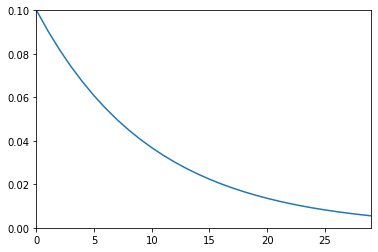

In [ ]:
# nを変えるとフィルタの長さが変わる
n = 30
filter_exp = np.exp(-np.arange(n)/(n/3))
filter_exp /= np.sum(filter_exp)
plt.plot(filter_exp)
plt.xlim(0, n-1)
plt.ylim(0, 0.1)
plt.show()

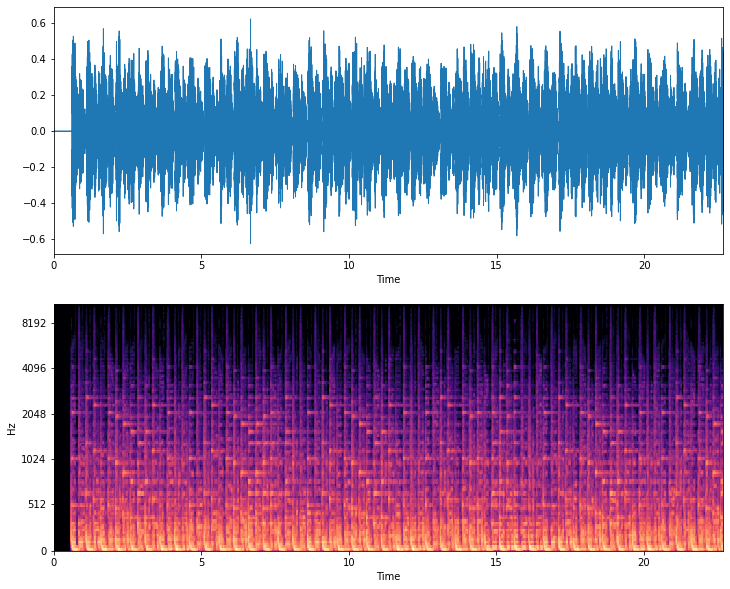

In [ ]:
y_tropical_filtered = np.convolve(y_tropical, filter_exp)
show_wave_spectrogram_audio(y_tropical_filtered, sr_tropical)

## 5. 窓関数（発展課題）

https://media.sys.wakayama-u.ac.jp/kawahara-lab/LOCAL/diss/diss7/S3_2.htm

フーリエ変換では、切り出した信号の端と端が

連続であるという仮定で計算を行う。

連続でない場合、意図しない高周波が出力される。

これを防ぐため、波形に対して窓関数をかける。

まずは、端と端が連続でない単純な信号をつくる。

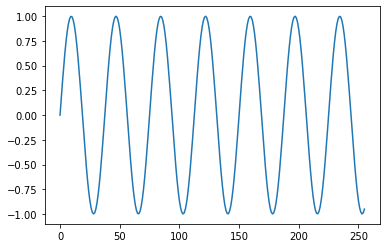

In [ ]:
data_n = 256
# ここで波形を作る（いまは6.8周期のsin波）
# 端と端が連続の例や、複数の周波数が重なった例を作ると良い
sine = np.sin(np.linspace(0, 6.8*2*np.pi, data_n))
plt.plot(sine)

In [ ]:
def power_spectrum(y):
  F = np.abs(np.fft.fft(y))
  F /= np.max(F)
  return F

この波形に対して、各種窓関数をかけていく

以下のような窓関数がある

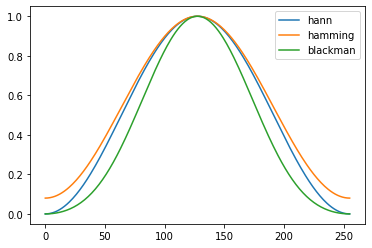

In [ ]:
t = np.arange(data_n)
hann = np.hanning(data_n)
hamming = np.hamming(data_n)
blackman = np.blackman(data_n)
plt.plot(t, hann, label='hann')
plt.plot(t, hamming, label='hamming')
plt.plot(t, blackman, label='blackman')
plt.legend()
plt.show()

ハニング窓をかけてみる

両方の波形に対して、FFTしてみる


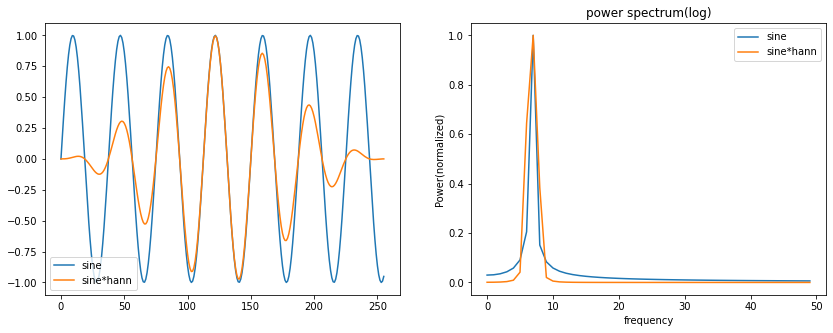

In [ ]:
fig, [ax1, ax2] = plt.subplots(1, 2, figsize=(14, 5))

hann = np.hanning(data_n)
sine_hann = sine * hann
ax1.plot(sine, label='sine')
ax1.plot(sine_hann, label='sine*hann')
ax1.legend()

F_sine = power_spectrum(sine)
ax2.plot(F_sine[:50], label='sine')
F_sine_hann = power_spectrum(sine_hann)
ax2.plot(F_sine_hann[:50], label='sine*hann')
ax2.set_title('power spectrum(log)')
ax2.set_xlabel('frequency')
ax2.set_ylabel('Power(normalized)')
ax2.legend()
fig.show()

ハニング窓をかけたほうが、ピークの周辺で減衰が早くなった

もうすこし複雑な波形で試してみる

ピークではとがっていたのが少しなまった気もするが、その周辺で減衰が早い

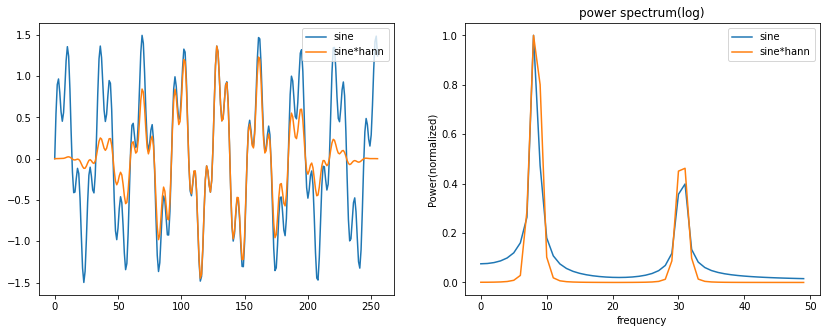

In [ ]:
fig, [ax1, ax2] = plt.subplots(1, 2, figsize=(14, 5))

data_n = 256
sine = np.sin(np.linspace(0, 8.3*2*np.pi, data_n)) + 0.5*np.sin(np.linspace(0, 30.4*2*np.pi, data_n))
hann = np.hanning(data_n)
sine_hann = sine * hann
ax1.plot(sine, label='sine')
ax1.plot(sine_hann, label='sine*hann')
ax1.legend()

F_sine = power_spectrum(sine)
ax2.plot(F_sine[:50], label='sine')
F_sine_hann = power_spectrum(sine_hann)
ax2.plot(F_sine_hann[:50], label='sine*hann')
ax2.set_title('power spectrum(log)')
ax2.set_xlabel('frequency')
ax2.set_ylabel('Power(normalized)')
ax2.legend()
fig.show()

## 6. サンプリングと波形の復元（発展課題）

まず、正弦波を荒くサンプリングする

No handles with labels found to put in legend.


[ 1.          0.30901699 -0.80901699 -0.80901699  0.30901699  1.
  0.30901699 -0.80901699 -0.80901699  0.30901699  1.          0.30901699
 -0.80901699 -0.80901699  0.30901699  1.        ]


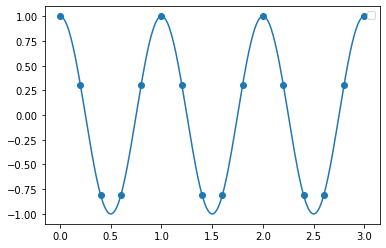

In [ ]:
# 周期あたり何点サンプリングするか。ここが2未満だとどうなるか？
sampling_per_period = 5

sampling_period = int(100 / sampling_per_period)
x = np.linspace(0, 3, 301)
y = np.cos(x*np.pi*2)
x_sampling = x[::sampling_period]
y_sampling = y[::sampling_period]
print(y_sampling)
plt.plot(x, y)
plt.scatter(x_sampling, y_sampling)
plt.legend()
plt.show()

サンプリングした点だけ出すと

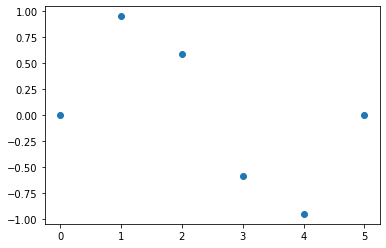

In [ ]:
plt.scatter(x_sampling, y_sampling)

これらの点をパルス列とみなして

sinc関数 $ \mathrm{sinc}(x) = \sin{x}/x $ を畳み込むことで、

波形の復元ができる

sinc関数はこんな形の関数


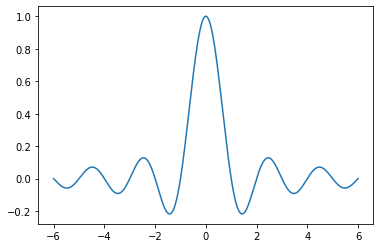

In [ ]:
x_temp = np.linspace(-6, 6, 1201)
plt.plot(x_temp, np.sinc(x_temp))

sinc関数を畳み込む

よく見ると、サンプリングした点は1つのsinc関数を除いて

すべて値が0になっている

サンプリングした点どうしを滑らかにつなぐような

線になっていることがわかる

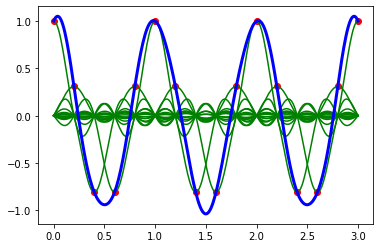

In [ ]:
sincs = []

for y_temp, x_temp in zip(y_sampling, x_sampling):
  sincs.append(y_temp * np.sinc(100 / sampling_period * (x_temp - x)))

for sinc in sincs:
  plt.plot(x, sinc, color = "green")

sum_sinc = sum(sincs)
plt.plot(x, sum_sinc, color="blue", lw=3)

plt.scatter(x_sampling, y_sampling, color="red")

## 7. 標本化定理（発展課題）

自然界のものを写真で撮ることを考えると、

アナログ値の標本化・量子化が必要になる。

標本化の都合で、デジタル画像にするときに

ある一定以上細かい模様を正しく記録することが出来ない。

右に行くほどしましま模様の画像でこれを試してみる。


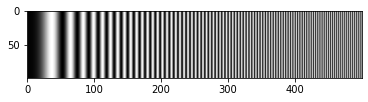

In [ ]:
# グレースケールで画像を読み込み
img_stripe = cv2.imread('/content/drive/MyDrive/stripe.png',0)
plt.gray()
plt.imshow(img_stripe)           
plt.show()

この画像を縮小してみる。

半分の大きさにする場合、単純に考えれば

１つ飛ばしで画素を取ってこればよい。

…はずなのだが、これを行うと右に行くほど細かくなるはずの模様が

あるところで折り返してしまった。

なぜだろうか？

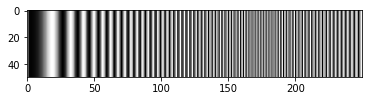

In [ ]:
img_stripe_resize = cv2.resize(img_stripe, dsize=None, fx=0.5, fy=0.5,interpolation=cv2.INTER_NEAREST)
plt.gray()
plt.imshow(img_stripe_resize)           
plt.show()

これを防ぐには、どうしたらよいだろうか？


## 8. 画像圧縮とDCT（挑戦的課題）

画像を8x8の領域に分割して、各領域でDCTを行い、

DCT係数をJPEGの仕様書にあるテーブルで量子化せよ。

これをIDCTで復元し、容量と画像の変化について調べよ。



参考：
https://github.com/yoyoyo-yo/Gasyori100knock
のQ36-40

## 9. 人の音声の周波数解析（挑戦的課題）

自分で母音`/a/`とか`/u/`とかの声を録音し、

FFTでスペクトルを表示せよ。

また、いろいろな母音を試してみて、**スペクトルのなかの周期性**について考察せよ。

キーワード：ケプストラム

## 10. 音階とコードの認識（挑戦的課題）

LibROSAによってクロマグラムを計算し、

そこからコードを認識せよ。

参考：
https://qiita.com/namaozi/items/31ea255ecc6a04320dfc

もっと高度なコード認識：
https://www.ee.columbia.edu/~dpwe/e4896/practicals.html#prac10

まずは、音階ごとのエネルギーであるクロマグラムを計算する

In [ ]:
def show_wave_chromagram_audio(y, sr, hpss=True, hop_length=512):
  fig, [ax_wave, ax_chromagram] = plt.subplots(2, 1, figsize=(12, 10))

  librosa.display.waveplot(y, sr=sr, x_axis='time', ax=ax_wave)
  # 打楽器音を除去する場合はhpss=True
  if hpss:
    y, _= librosa.effects.hpss(y)
  C = librosa.feature.chroma_cqt(y=y, sr=sr, hop_length=hop_length)
  chromagram = librosa.display.specshow(C, sr=sr, x_axis='time', y_axis='chroma', ax=ax_chromagram)
  plt.show()
  print(C.shape)
  display(Audio(y, rate=sr))

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


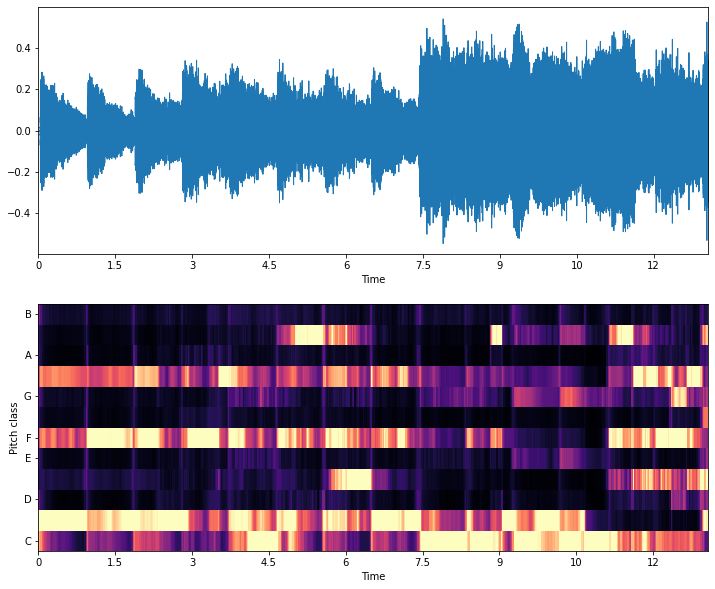

(12, 563)


In [ ]:
y, sr = librosa.load('/content/drive/MyDrive/kagerou.mp3')
y = y[12000:300000]

hop_length = 512
show_wave_chromagram_audio(y, sr, hpss=False, hop_length=hop_length)


時間ごとのクロマグラムを計算できたので、

適当な間隔（2拍とか）で合計する

→上位3つの示すコードをその場面でのコードとしたらどうか？

In [ ]:
C = librosa.feature.chroma_cqt(y=y, sr=sr, hop_length=hop_length)

bpm = 65
sample_n_per_beat = int(60 * sr / 120 / hop_length)
chroma_sum_n = 2 * sample_n_per_beat
sum_chroma = [0 for x in range(12)]

for t in range(chroma_sum_n):
  for i in range(12):
    sum_chroma[i] += C[i][t]

tones = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']

for chroma, tone in zip(reversed(sum_chroma), reversed(tones)):
  print('{:2}: {:5.2f}'.format(tone, chroma))

B :  5.23
A#:  2.84
A :  2.47
G#: 29.38
G :  4.55
F#:  3.41
F : 26.93
E :  3.47
D#:  5.88
D :  3.37
C#: 41.85
C : 14.31


上記だと、`C#, F, G#` 次に`C`が大きいので、

コードは`C#`もしくは`C#M7`と推定できる

もう少し高度に、コードのテンプレートとのcos類似度をとる方法も考えられる